<a href="https://colab.research.google.com/github/danon6868/BI-ml-2023/blob/main/lecture_9_10_cnn/homework/hw_cnn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Задание 1. Свёртка

**5 баллов**

Реализуйте функцию свёртки `conv(x, kernel, stride, pad)`, где:


* $\text{x}$: Двумерный массив размером $(W,H)$;
* $\text{kernel}$: ядро свёртки размером $(K, K)$;
* $\text{stride}$: шаг ядра свёртки. $0 < \text{stride} \leq \min(W,H)$;
* $\text{pad}$: ширина дополнения с каждой из сторон массива. $\text{pad} > 0$.

Результатм работы функции является возвращение следующего значения:
* $out$: Результат свертки входных данных $\text{x}$, имеющий размер $(H', W')$: 
  - $H' = 1 + (H + 2 \cdot pad - K)\ //\  stride$;
  - $W' = 1 + (W + 2 \cdot pad - K)\  //\ stride$.

---

Воспользуйтесь созданной функцией `conv` для применения [оператора Собеля](https://ru.wikipedia.org/wiki/%D0%9E%D0%BF%D0%B5%D1%80%D0%B0%D1%82%D0%BE%D1%80_%D0%A1%D0%BE%D0%B1%D0%B5%D0%BB%D1%8F) 
к изображению, после чего выведите результат на экран.

Можно работать и с `numpy`, и с `torch`, как вам угодно.

In [1]:
import torch
import numpy as np

In [2]:
# Можете тренироваться на этом примере
a = np.arange(9).reshape((3, 3))
M = np.block([[a, a],[a, a]])
print(M)

[[0 1 2 0 1 2]
 [3 4 5 3 4 5]
 [6 7 8 6 7 8]
 [0 1 2 0 1 2]
 [3 4 5 3 4 5]
 [6 7 8 6 7 8]]


In [3]:
import torch.nn.functional as F


def conv(x, kernel, stride, pad):    
    H = x.shape[0]
    W = x.shape[1]
    
    # padding x
    x = torch.from_numpy(x)
    x = F.pad(x, pad=(pad, pad, pad, pad), mode='constant', value=0)
    
    # calculating sizes for convolution
    K = kernel.shape[0]
    H_conv = 1 + (H + 2 * pad - K) // stride
    W_conv = 1 + (W + 2 * pad - K) // stride
    x_conv = torch.zeros((H_conv, W_conv))
    
    # x convolution
    row, col = 0, 0
    while row < H - K:
        while col < W - K:
            x_conv[row // stride][col // stride] = (x[row:(row+K), col:(col+K)] * kernel).sum()
            col += stride
        col = 0
        row += stride
    return x_conv

In [4]:
sobel_kernel_vert = torch.Tensor([
                                  [-1, 0, 1],
                                  [-2, 0, 2],
                                  [-1, 0, 1]
])


sobel_kernel_hor = torch.Tensor([
                                 [-1, -2, -1],
                                 [0, 0, 0],
                                 [1, 2, 1]
])

Примените эти два фильтра к следующей картинке и нарисуйте полученные результаты:

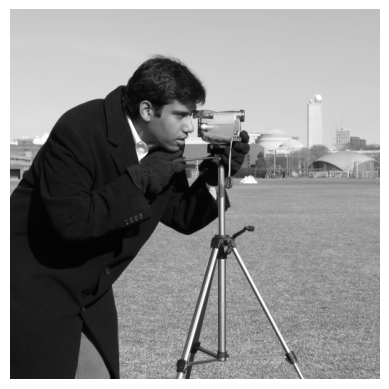

In [5]:
from skimage import data
import matplotlib.pyplot as plt

camera = data.camera()
plt.figure()
plt.imshow(camera.astype("int"), cmap="gray", vmin=0, vmax=255)
plt.axis("off");

Допишите код ниже и проинтерпретируйте полученный результат:

In [7]:
camera_s_hor_filter = conv(camera, sobel_kernel_hor, stride=1, pad=1)
camera_s_vert_filter = conv(camera, sobel_kernel_vert, stride=1, pad=1)
camera_with_borders = np.sqrt(camera_s_hor_filter**2 + camera_s_vert_filter**2)

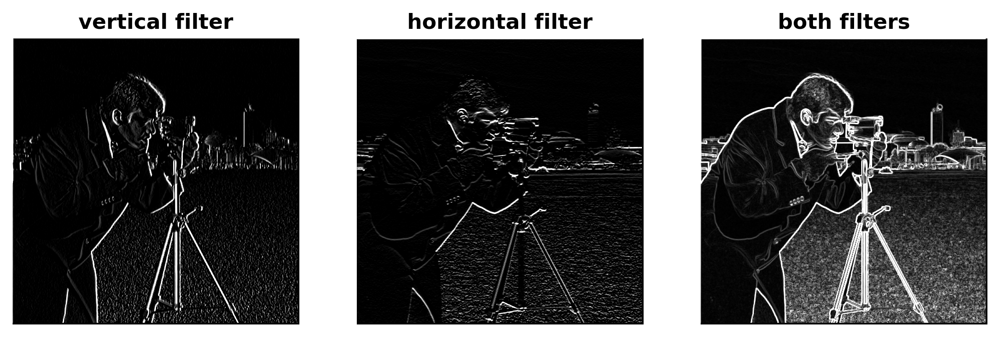

In [8]:
pictures = [
    ("vertical filter", camera_s_vert_filter),
    ("horizontal filter", camera_s_hor_filter),
    ("both filters", camera_with_borders)
]

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(10,5), dpi=300)
for i, pic in enumerate(pictures):
    axes[i].imshow(pic[1], vmin=0, vmax=255, cmap="gray")
    axes[i].set_title(pic[0], fontweight="bold")
    axes[i].axis("off")

We amplified horizontal and vertical lines in the picture by applying Sobel operators (`sobel_kernel_vert` and `sobel_kernel_hor`, respectively). The resulted picture is an overlay of both masks with contrast borders.

## Задание 2. AlexNet

**15 баллов**

Воссоздайте архитектуру `AlexNet` для определения заболевания растения. Датасеты уже созданы ниже.

In [31]:
INPUT_IMAGE_SIZE = 227
BATCH_SIZE = 64
N_EPOCHS = 10 # можно будет при желании увеличить
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

In [10]:
print(DEVICE)

cuda


In [11]:
from IPython.display import clear_output

from torchvision.io import read_image
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import ToTensor, Compose, ToPILImage
from torchvision.transforms import Normalize, Resize

from glob import glob
from torch import nn
from torch.nn import functional as F
import torch
import os
 
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime

In [13]:
!wget https://storage.googleapis.com/ibeans/train.zip
!wget https://storage.googleapis.com/ibeans/validation.zip
!wget https://storage.googleapis.com/ibeans/test.zip

clear_output()

In [14]:
!unzip train.zip
!unzip validation.zip
!unzip test.zip

clear_output()

In [12]:
class BeanDataset(Dataset):
    def __init__(self, img_dir, side_size=INPUT_IMAGE_SIZE):
        # папка с картинками
        self.img_dir = img_dir
        # отсортированный список с названиями файлов
        self.files = sorted(glob(f'{img_dir}/*/*.jpg'))
        class_names = sorted(os.listdir(img_dir))
        # названия папок с картинками переведем в номера классов
        self.class_dir = {name:idx for idx, name in enumerate(class_names)}
        self._number_to_labels = {idx:name for idx, name in enumerate(class_names)}

        # трансформации данных: мы изменяем размер,
        # так как AlexNet работает с картинками 227 на 227 пикселей
        self.transforms = Compose([ToPILImage(),
                                  Resize(side_size),
                                  ToTensor(),
                                  Normalize(
                                      mean = [0.5183, 0.4845, 0.6570],
                                      std = [0.2111, 0.2227, 0.2291]
                                  )])
        self._transforms_for_plot = Compose([ToPILImage(),
                                  Resize(side_size),
                                  ToTensor()
                                  ])


    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx, normalize=True):
        file_path = self.files[idx]
        image = read_image(file_path).type(torch.DoubleTensor)

        # применяем трансформации
        if normalize:
            transformed_img = self.transforms(image)
        
        transformed_img = self._transforms_for_plot(image)
        
        label_name = file_path.split('/')[-2]
        label = self.class_dir[label_name]
        
        # как обычно возвращаем картинку и номер класса
        return transformed_img, label

In [13]:
train_dataset = BeanDataset("./train/")
valid_dataset = BeanDataset("./validation/")
test_dataset = BeanDataset("./test/")

trainloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
validloader = DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False)
testloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

Посмотрим на наши картинки:

(код довольно эзотерический, но у меня было такое настроение)

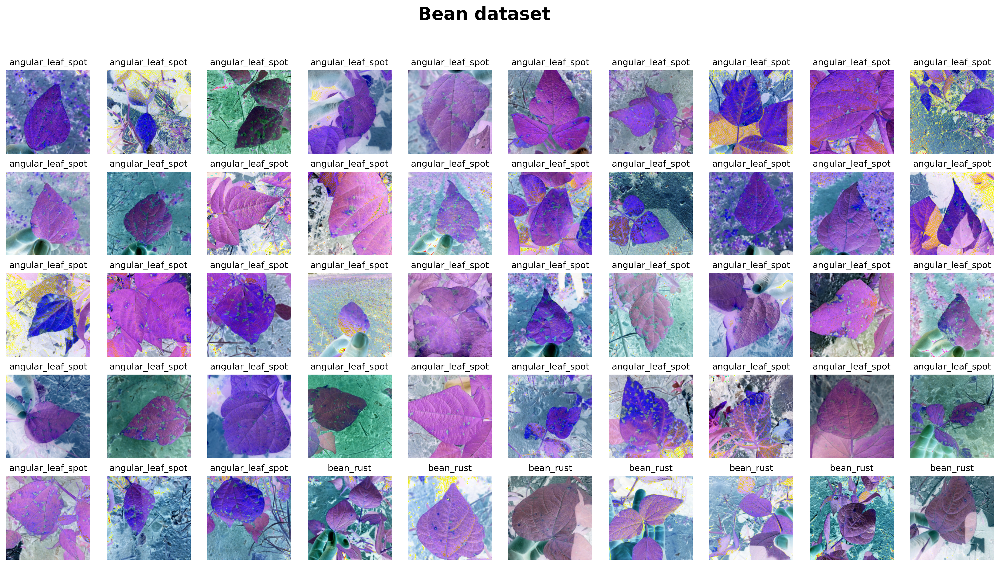

In [14]:
ROW_IMG = 10
N_ROWS = 5

fig = plt.figure(figsize=(20, 10), dpi=300)
for index in range(1, ROW_IMG * N_ROWS + 1):
    plt.subplot(N_ROWS, ROW_IMG, index)
    plt.axis('off')
    plt.imshow(valid_dataset.__getitem__(index, normalize=False)[0].permute(1, 2, 0))
    title = valid_dataset._number_to_labels[valid_dataset.__getitem__(index, normalize=False)[1]]
    plt.title(title, fontsize=10)
    
fig.suptitle("Bean dataset", fontsize=20, fontweight="bold");

### Реализация `AlexNet`

В лекции мы познакомились с архитектурой `AlexNet`, теперь пришло время реализовать ее самостоятельно. Важно, что на выходе число классов у нас будет сильно меньше чем 1000, нужно будет в начале это определить. Везде в качестве активации используется `ReLU`.

Также обратите внимание на параметры пулинга, тут ядро 3х3 со страйдом 2 (поэтому он называется overlapping).

Картинка может немного отличаться от того, что было на лекции, ориентируйтесь на картинку в ноутбуке.

Внимательно смотрите на параметры сверток (например, padding / stride).

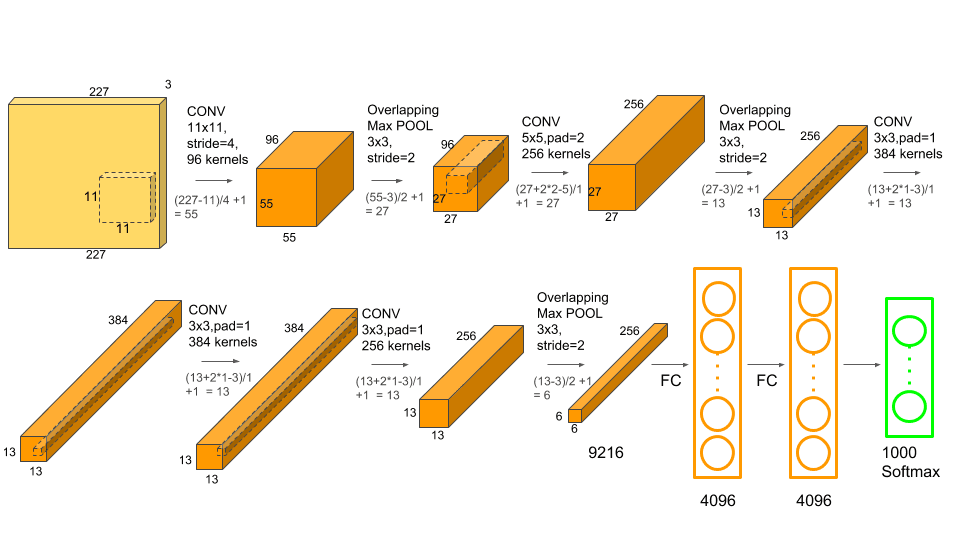

In [20]:
# determing number of classes
train_dataset._number_to_labels

{0: 'angular_leaf_spot', 1: 'bean_rust', 2: 'healthy'}

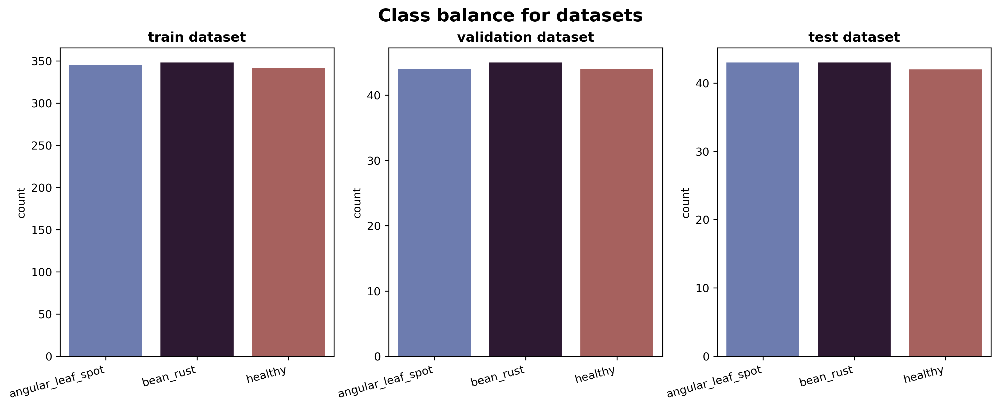

In [21]:
datasets = [
    ("train dataset", train_dataset), 
    ("validation dataset", valid_dataset),
    ("test dataset", test_dataset)
]

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15,5), dpi=300)
for i, data in enumerate(datasets):
    labels = []
    for pic in range(len(data[1])):
        label_num = data[1].__getitem__(pic, normalize=False)[1]
        labels.append(data[1]._number_to_labels[label_num])
    sns.countplot(x=labels, palette="twilight", ax=axes[i])
    axes[i].set_title(data[0], fontweight="bold")
    axes[i].set_xticklabels(labels=data[1]._number_to_labels.values(), 
                            rotation=15, ha='right')
plt.suptitle("Class balance for datasets", fontsize=16, fontweight="bold");

In [32]:
N_CLASSES = 3 # определите число классов в данных
LEARNING_RATE = 3e-4 # можно подобрать как-то другой)

I decided to look at `AlexNet` model from `torch`. Its structure differs from those on given picture for this task.

In [15]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'alexnet', pretrained=True)

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/root/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

In [22]:
model.load_state_dict

<bound method Module.load_state_dict of AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_featur

In [30]:
class AlexNet(nn.Module):
    def __init__(self, n_classes):
        super().__init__()
        
        self.n_classes = n_classes
        self.feature_extractor = nn.Sequential(            
            nn.Conv2d(in_channels=3, out_channels=96, kernel_size=11, stride=4),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=3, stride=2),
            nn.Conv2d(in_channels=96, out_channels=256, kernel_size=5, stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=3, stride=2),
            nn.Conv2d(in_channels=256, out_channels=384, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Conv2d(in_channels=384, out_channels=384, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Conv2d(in_channels=384, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=3, stride=2)
        )
        
        self.classifier = nn.Sequential(
            nn.Linear(in_features=9216, out_features=4096),
            nn.ReLU(),
            nn.Linear(in_features=4096, out_features=4096),
            nn.ReLU(),
            nn.Linear(in_features=4096, out_features=self.n_classes)
        )
            
            
    def forward(self, x):
        x = self.feature_extractor(x)
        x = torch.flatten(x, 1)
        logits = self.classifier(x)
        probs = F.softmax(logits, dim=1)
        return logits, probs

Возьмите код для обучения и валидации модели, который был на лекции (если захочется, то его можно как угодно менять). В лекции мы возвращали из модели помимо логитов еще и вероятности классов, чтобы потом рисовать красивые картинки. Если захотите сделать также, то учтите это.

In [56]:
def train_epoch(train_loader, model, criterion, optimizer, device):
    """
    Function for the training step of the training loop
    """

    model.train()
    running_loss = 0
    
    for X, y_true in train_loader:

        optimizer.zero_grad()
        
        X = X.to(device)
        y_true = y_true.to(device)

        y_hat, _ = model(X) 
        loss = criterion(y_hat, y_true) 
        running_loss += loss.item() * X.size(0)

        loss.backward()
        optimizer.step()
        
    epoch_loss = running_loss / len(train_loader.dataset)
    return model, optimizer, epoch_loss


def validate_epoch(valid_loader, model, criterion, device):
    """
    Function for the validation step of the training loop
    """
   
    model.eval()
    running_loss = 0
    
    for X, y_true in valid_loader:
    
        X = X.to(device)
        y_true = y_true.to(device)

        y_hat, _ = model(X) 
        loss = criterion(y_hat, y_true) 
        running_loss += loss.item() * X.size(0)

    epoch_loss = running_loss / len(valid_loader.dataset)
        
    return model, epoch_loss


def get_accuracy(model, dataloader, device):
    """
    model - 
    dataloader - 
    """
    correct = 0
    total = 0
    with torch.no_grad(): # Тензоры внутри этого блока будут иметь requires_grad=False
        for images, labels in dataloader:
            images, labels = images.to(device), labels.to(device)
            outputs, _ = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    accuracy = correct / total
    
    return accuracy


def plot_losses(train_losses, valid_losses):
    sns.lineplot(x=np.arange(1, len(train_losses)+1), y=train_losses, label="Train Loss")
    sns.lineplot(x=np.arange(1, len(train_losses)+1), y=valid_losses, label="Validation Loss")


def training_loop(model, criterion, optimizer, train_loader, valid_loader, epochs, device, print_every=1):
    """
    Function defining the entire training loop
    """

    best_loss = 1e10
    train_losses = []
    valid_losses = []
 
    # Train model
    for epoch in range(0, epochs):

        # training
        model, optimizer, train_loss = train_epoch(train_loader, model, criterion, optimizer, device)
        train_losses.append(train_loss)

        # validation
        with torch.no_grad():
            model, valid_loss = validate_epoch(valid_loader, model, criterion, device)
            valid_losses.append(valid_loss)

        if epoch % print_every == (print_every - 1):
            
            train_acc = get_accuracy(model, train_loader, device=device)
            valid_acc = get_accuracy(model, valid_loader, device=device)
                
            print(f'{datetime.now().time().replace(microsecond=0)} --- '
                  f'Epoch: {epoch}\t'
                  f'Train loss: {train_loss:.4f}\t'
                  f'Valid loss: {valid_loss:.4f}\t'
                  f'Train accuracy: {100 * train_acc:.2f}\t'
                  f'Valid accuracy: {100 * valid_acc:.2f}')

    return model, train_losses, valid_losses

Выберите функцию потерь и оптимизатор и обучите полученную модель на тренировочных данных, параллельно проверяя ее на валидационной части:

Adam
21:05:56 --- Epoch: 0	Train loss: 1.0993	Valid loss: 1.0893	Train accuracy: 56.87	Valid accuracy: 55.64
21:06:20 --- Epoch: 1	Train loss: 1.0428	Valid loss: 0.9734	Train accuracy: 52.80	Valid accuracy: 51.88
21:06:43 --- Epoch: 2	Train loss: 0.8827	Valid loss: 0.7631	Train accuracy: 69.63	Valid accuracy: 69.92
21:07:09 --- Epoch: 3	Train loss: 0.7994	Valid loss: 1.5630	Train accuracy: 48.07	Valid accuracy: 47.37
21:07:34 --- Epoch: 4	Train loss: 0.7963	Valid loss: 0.6857	Train accuracy: 73.31	Valid accuracy: 75.19
21:08:00 --- Epoch: 5	Train loss: 0.6530	Valid loss: 0.6076	Train accuracy: 75.34	Valid accuracy: 78.20
21:08:26 --- Epoch: 6	Train loss: 0.6570	Valid loss: 0.5646	Train accuracy: 77.56	Valid accuracy: 78.95
21:08:52 --- Epoch: 7	Train loss: 0.6130	Valid loss: 0.5397	Train accuracy: 77.66	Valid accuracy: 78.20
21:09:13 --- Epoch: 8	Train loss: 0.5520	Valid loss: 0.5509	Train accuracy: 75.34	Valid accuracy: 75.94
21:09:36 --- Epoch: 9	Train loss: 0.5459	Valid loss: 0.5437

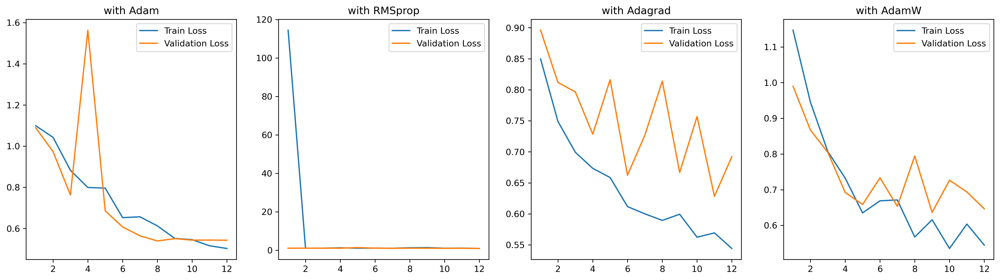

In [74]:
from torch.optim import Adam, RMSprop, Adagrad, AdamW


N_CLASSES = 3
N_EPOCHS = 12
LEARNING_RATE = 3e-4
model = AlexNet(N_CLASSES).to(DEVICE)
criterion = nn.CrossEntropyLoss()
optims = [Adam, RMSprop, Adagrad, AdamW]

fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,5), dpi=300)
for i, optim in enumerate(optims):
    print(optim.__name__)
    optimizer = optim(model.parameters(), lr=LEARNING_RATE)
    model, train_losses, valid_losses = training_loop(model, criterion, optimizer, trainloader, validloader, N_EPOCHS, DEVICE)
    print(f"accuracy score with {optim.__name__} optimizer for test dataset: {get_accuracy(model, testloader, DEVICE)}")
    sns.lineplot(x=np.arange(1, len(train_losses)+1), y=train_losses, label="Train Loss", ax=axes[i])
    sns.lineplot(x=np.arange(1, len(train_losses)+1), y=valid_losses, label="Validation Loss", ax=axes[i])
    axes[i].set_title(f"with {optim.__name__}")

Если вы все реализовали правильно, то `accuracy` на валидации должна быть в районе 0.8.

With `Adam` and `Adagrad` optimizers, using our `AlexNet` accuracy scores for test dataset are same and the highest. I decided to use `Adam`.

### Визуализация предсказаний

Визуализируем предсказания нашей модели и степень уверенности в них. Сделайте выводы о качестве полученной модели.

In [78]:
N_CLASSES = 3
N_EPOCHS = 12
LEARNING_RATE = 3e-4

model = AlexNet(N_CLASSES).to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
criterion = nn.CrossEntropyLoss()
model, train_losses, valid_losses = training_loop(model, criterion, optimizer, trainloader, validloader, N_EPOCHS, DEVICE)
print(f"accuracy score with {optim.__name__} optimizer for test dataset: {get_accuracy(model, testloader, DEVICE)}")

21:49:11 --- Epoch: 0	Train loss: 1.1020	Valid loss: 1.1003	Train accuracy: 32.98	Valid accuracy: 33.08
21:49:43 --- Epoch: 1	Train loss: 1.0904	Valid loss: 1.0971	Train accuracy: 34.33	Valid accuracy: 34.59
21:50:10 --- Epoch: 2	Train loss: 0.9664	Valid loss: 0.8376	Train accuracy: 60.83	Valid accuracy: 59.40
21:50:39 --- Epoch: 3	Train loss: 0.7967	Valid loss: 0.7407	Train accuracy: 71.47	Valid accuracy: 73.68
21:51:06 --- Epoch: 4	Train loss: 0.7274	Valid loss: 1.6224	Train accuracy: 53.87	Valid accuracy: 48.12
21:51:30 --- Epoch: 5	Train loss: 0.8612	Valid loss: 0.7890	Train accuracy: 62.96	Valid accuracy: 60.90
21:51:55 --- Epoch: 6	Train loss: 0.7162	Valid loss: 0.6573	Train accuracy: 73.31	Valid accuracy: 74.44
21:52:21 --- Epoch: 7	Train loss: 0.6514	Valid loss: 0.6609	Train accuracy: 73.60	Valid accuracy: 74.44
21:52:47 --- Epoch: 8	Train loss: 0.6068	Valid loss: 0.6292	Train accuracy: 73.89	Valid accuracy: 72.93
21:53:12 --- Epoch: 9	Train loss: 0.6081	Valid loss: 0.5776	Trai

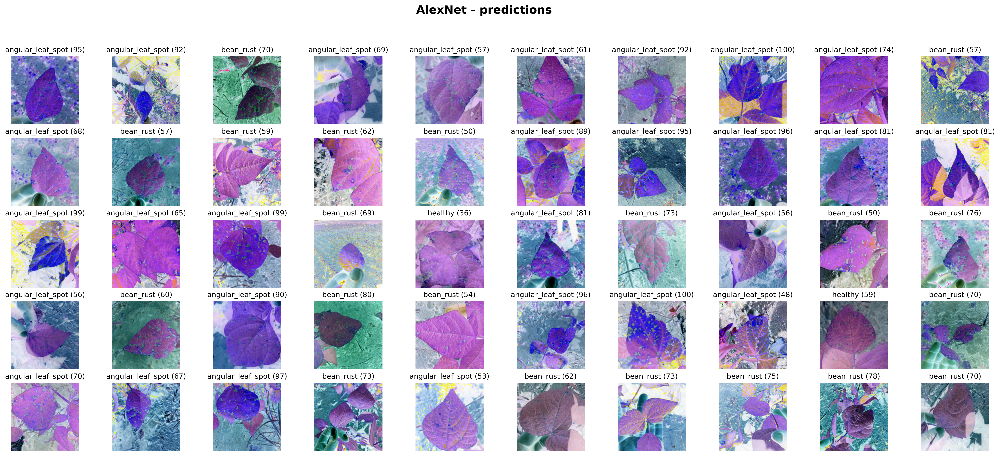

In [80]:
ROW_IMG = 10
N_ROWS = 5

fig = plt.figure(figsize=(25, 10), dpi=300)
for index in range(1, ROW_IMG * N_ROWS + 1):
    plt.subplot(N_ROWS, ROW_IMG, index)
    plt.axis('off')
    plt.imshow(valid_dataset.__getitem__(index, normalize=False)[0].permute(1, 2, 0))
    
    with torch.no_grad():
        # error)
        model.cpu().eval()
        _, probs = model(valid_dataset[index][0].unsqueeze(0))
        
    title = f'{torch.argmax(probs)} ({torch.max(probs * 100):.0f}%)'
    title = f"{valid_dataset._number_to_labels[torch.argmax(probs).item()]} ({torch.max(probs * 100):.0f})"
    
    plt.title(title, fontsize=10)
fig.suptitle('AlexNet - predictions', fontsize=16, fontweight="bold");

## Задание 3. И снова социализация

**1 дополнительный балл**

Однажды такое уже бывало, но почему бы не повторить. Сходите погулять вместе с одногруппниками или созвонитесь в зуме, а сюда прикрепите какие-нибудь фотографии и кратко опишите, на какие темы вы общались)

Тут, как обычно, можно описать свои эмоции от выполнения этого задания:

**Ответ:**